# DiaSource counts DC2 ImSim Image Differencing with Gen3 DRP Pipeline
## 5 yr depth tract 4431 i-band only



Like https://github.com/yalsayyad/dm_notebooks/blob/master/examples/DiaSourceCensusCcdVisitNight-HSC-RC2.ipynb, this is an exploration of diaSource counts per visit/CCD/Visit but with the newly processed DC2 data:
    

DiaSources can be counted a few different ways:
* All DiaSource Rows
* All DiaSource Rows with no pixel flags



## Background: Image differencing in the stack

* 2013 "Preconvolution" test with simulated and Stripe 82 data: [Becker et al 2013]( https://docushare.lsst.org/docushare/dsweb/Get/LDM-227)
* 2016  with Decam Data: https://dmtn-006.lsst.io/
* 2016 "Decorrelation" test with simulated and decam data. https://dmtn-021.lsst.io/


# 1) Data

```
(lsst-scipipe) [yusra@lsst-devl01 dc2_w_2021_20]$ bps report --id 338646
X      STATE  %S        ID OPERATOR   PRJ        CMPGN                PAYLOAD              RUN
------------------------------------------------------------------------------------------------------------------------------------------------------------
      FAILED  96  338646.0 yusra      DC2        reprocessing         test-med-1-rerun     u_yusra_w_2021_21_diffim_20210523T185516Z



Path: /project/yusra/dc2_w_2021_20/submit/u/yusra/w_2021_21_diffim/20210523T185516Z
                     UNKNOW | MISFIT | UNREAD | READY  | PENDIN | RUNNIN | DELETE | HELD   | SUCCEE | FAILED
Total                     0 |      0 |    263 |      0 |      0 |      0 |      0 |      0 |  14797 |    263
---------------------------------------------------------------------------------------------------------------
pipetaskInit              0 |      0 |      0 |      0 |      0 |      0 |      0 |      0 |      1 |      0
selectGoodSeeingVisits    0 |      0 |      0 |      0 |      0 |      0 |      0 |      0 |     49 |      0
templateGen               0 |      0 |      0 |      0 |      0 |      0 |      0 |      0 |     49 |      0
imageDifference           0 |      0 |      0 |      0 |      0 |      0 |      0 |      0 |   7349 |    263
transformDiaSourceCat     0 |      0 |    263 |      0 |      0 |      0 |      0 |      0 |   7349 |      0


```



![HSC CCD Layout](https://hsc.mtk.nao.ac.jp/pipedoc_e/_images/CCDPosition_20140811-1.png)


## Load and Transform Data

In [2]:
import os
import numpy as np
import scipy
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import sqlite3
import lsst.daf.persistence as dafPersist
import lsst.afw.display as afwDisplay
import lsst.afw.display as afw_display
import lsst.geom
afwDisplay.setDefaultBackend('matplotlib')
import matplotlib.ticker as plticker
import lsst.afw.cameraGeom.testUtils as testUtils
import lsst.afw.cameraGeom as cameraGeom
from lsst.obs.hsc import HscMapper as mapper
import lsst.daf.butler as dafButler
from skimage.filters import gaussian
from lsst.ap.association import UnpackApdbFlags, TransformDiaSourceCatalogConfig
import pandas as pd
os.environ['PGPASSFILE'] = "/home/yusra/.lsst/.pgpassfile"

In [12]:
import lsst.daf.butler as dafButler
PARENT_REPO = " 2.2i/defaults"
butler = dafButler.Butler('/repo/dc2', collections='u/yusra/w_2021_21_diffim')

In [42]:
set([dataId['visit'] for dataId in butler.registry.queryDataIds(["visit", "band"], datasets="diaSourceTable",
                                                                collections='u/yusra/w_2021_21_diffim', 
                                                                where="instrument='LSSTCam-imSim' AND tract=4431")]))

284

In [14]:
visits =  butler.registry.queryDataIds(["visit", "band"], datasets="diaSourceTable", collections='u/yusra/w_2021_21_diffim', where="instrument='LSSTCam-imSim' AND tract=4431")

In [15]:
tuples = set([(dataId['band'], dataId['visit']) for dataId in visits])

In [16]:
from operator import itemgetter
from itertools import groupby

In [17]:
visitDict =  {key: [] for key in set(dataId['band'] for dataId in visits)}
#for band, visit in tuples:
for k, v in tuples:
    visitDict[k].append(v)

In [18]:
visits = list(set(visitDict['i']))

In [19]:
tables = []
for v in visits:
    tables.append(butler.get('diaSourceTable', dataId={'visit': v}))
    
df = pd.concat(tables)

In [20]:
len(visits)

292

In [21]:
#df = diaSourceTable
config = TransformDiaSourceCatalogConfig()
unpacker = UnpackApdbFlags(config.flagMap, 'DiaSource')
flag_values = unpacker.unpack(df['flags'], 'flags')
flag_names = list(flag_values.dtype.names)


In [22]:
flags = pd.DataFrame(flag_values, index=df.index)
df = pd.concat([df, flags], axis=1)

In [23]:
instrumentDataId = butler.registry.expandDataId(instrument='LSSTCam-imSim')
packer = butler.registry.dimensions.makePacker("visit_detector", instrumentDataId)

In [24]:
df['visit'] = df.ccdVisitId.apply(lambda x: packer.unpack(x)['visit'])
df['detector'] = df.ccdVisitId.apply(lambda x: packer.unpack(x)['detector'])

In [37]:
# create some derived columns
pixToArcseconds = 0.2
PIXEL_SCALE = 0.2
SIGMA2FWHM = 2*np.sqrt(2*np.log(2))
#  Ixx already in arcseconds! functor: ConvertPixelSqToArcsecondsSq
traceRadius = np.sqrt(0.5) * np.sqrt(df.IxxPsf + df.IyyPsf)
df['seeing'] = SIGMA2FWHM * traceRadius

In [38]:
# get Focal Plane Coordinates (is there a faster way to do this?)
camera = butler.get('camera', instrument='LSSTCam-imSim')

def ccd2focalPlane(x, y, ccd):
    cc = int(ccd)
    det = camera[cc]
    point = det.transform(lsst.geom.Point2D(x, y), cameraGeom.PIXELS, cameraGeom.FOCAL_PLANE)
    return point[0], point[1]

vecCcd2FP =  np.vectorize(ccd2focalPlane)
focal_plane = vecCcd2FP(df['x'].values.astype(float), df['y'].values.astype(float), df['detector'].values.astype(int))
df['xFP'] = focal_plane[0]
df['yFP'] = focal_plane[1]

In [39]:
bbox = butler.get('goodSeeingDiff_differenceExp.bbox', visit=visits[0] , detector=5)
wcs = butler.get('goodSeeingDiff_differenceExp.wcs', visit=visits[0], detector=5)
APPROX_CCD_AREA = bbox.getArea()*wcs.getPixelScale().asDegrees()**2

In [229]:
pixelFlagNames = ['base_PixelFlags_flag',
 'base_PixelFlags_flag_offimage',
 'base_PixelFlags_flag_edge',
 'base_PixelFlags_flag_interpolated',
 'base_PixelFlags_flag_saturated',
 'base_PixelFlags_flag_cr',
 'base_PixelFlags_flag_bad',
 'base_PixelFlags_flag_suspect',
 'base_PixelFlags_flag_interpolatedCenter',
 'base_PixelFlags_flag_saturatedCenter',
 'base_PixelFlags_flag_crCenter',
 'base_PixelFlags_flag_suspectCenter',]
centroidFlagNames = ['slot_Centroid_flag',
 'slot_Centroid_pos_flag',
 'slot_Centroid_neg_flag',]
fluxFlagNames = ['slot_ApFlux_flag',
 'slot_ApFlux_flag_apertureTruncated',
 'slot_PsfFlux_flag',
 'slot_PsfFlux_flag_noGoodPixels',
 'slot_PsfFlux_flag_edge',
 'ip_diffim_forced_PsfFlux_flag',
 'ip_diffim_forced_PsfFlux_flag_noGoodPixels',
 'ip_diffim_forced_PsfFlux_flag_edge',]
shapeFlagNames =  ['slot_Shape_flag',
 'slot_Shape_flag_unweightedBad',
 'slot_Shape_flag_unweighted',
 'slot_Shape_flag_shift',
 'slot_Shape_flag_maxIter',
 'slot_Shape_flag_psf']

badFlagNames =  [
 'base_PixelFlags_flag_offimage',
 'base_PixelFlags_flag_edge',
 'base_PixelFlags_flag_saturated',
 'base_PixelFlags_flag_cr',
 'base_PixelFlags_flag_bad',
 'base_PixelFlags_flag_suspect']

In [41]:
def plot2axes(x1, y1, x2, y2, xlabel, ylabel1, ylabel2):
    fig, ax1 = plt.subplots(figsize=(16,6))
    color = 'tab:red'
    ax1.set_xlabel(xlabel)
    ax1.set_ylabel(ylabel1, color=color)
    a = np.arange(len(x1))
    ax1.plot(a, y1, color=color)
    ax1.xaxis.set_ticks(a) #set the ticks to be a
    ax1.xaxis.set_ticklabels(x1)
    
    ax1.tick_params(axis='y', labelcolor=color)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color = 'tab:blue'
    ax2.set_ylabel(ylabel2, color=color)  # we already handled the x-label with ax1
    ax2.plot(a, y2, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    for label in ax1.get_xticklabels():
        label.set_ha("right")
        label.set_rotation(90)

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.show()

# 2)  DiaSources per visit

A few different ways to look at false positives as a function of visits. Most of the variance in diaSources can be explained by the seeing. If the visit PSF is smaller than the template PSF, the template PSF is deconvolved, in which any inaccuracy in the PSF model is amplified. This causes the clear relationship below where false positives improve as the PSF size increases:

In [30]:
df

,diaSourceId,ccdVisitId,filterName,diaObjectId,parentDiaSourceId,midPointTai,pixelId,bboxSize,flags,ra,...,slot_Shape_flag_unweightedBad,slot_Shape_flag_unweighted,slot_Shape_flag_shift,slot_Shape_flag_maxIter,slot_Shape_flag_psf,visit,detector,seeing,xFP,yFP
0,507701105275174918,945667001,i,0,0,60964.182672,0,14,0,54.834281,...,False,False,False,False,False,945667,1,0.566332,-107.818018,-283.448606
1,507701105275174919,945667001,i,0,0,60964.182672,0,48,25166620,54.825149,...,True,False,False,False,False,945667,1,0.566330,-109.219120,-283.130532
2,507701105275174920,945667001,i,0,0,60964.182672,0,17,25296896,54.752516,...,True,False,False,False,False,945667,1,0.566298,-121.278181,-282.601853
3,507701105275174921,945667001,i,0,0,60964.182672,0,17,25165824,54.781163,...,True,False,False,False,False,945667,1,0.566346,-114.837478,-279.122063
0,507701106885787668,945667004,i,0,0,60964.182672,0,19,25165824,54.780563,...,True,False,False,False,False,945667,4,0.566642,-112.278850,-273.385435
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
128,625896547434889554,1165823168,i,0,0,61286.318118,0,28,25165824,55.873671,...,True,False,False,False,False,1165823,168,0.727937,-182.587489,314.943858
129,625896547434889555,1165823168,i,0,0,61286.318118,0,18,25165824,55.754922,...,True,False,False,False,False,1165823,168,0.728049,-163.977031,315.002798
130,625896547434889556,1165823168,i,0,0,61286.318118,0,19,0,55.891663,...,False,False,False,False,False,1165823,168,0.727912,-185.563929,315.602466
131,625896547434889557,1165823168,i,0,0,61286.318118,0,40,25165824,55.890596,...,True,False,False,False,False,1165823,168,0.727912,-185.425003,315.724389


Text(0.5, 0, 'FWHM')

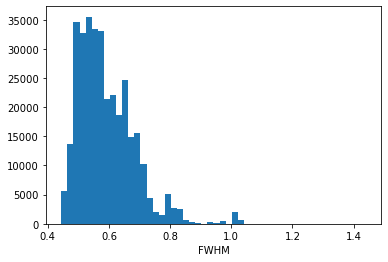

In [36]:
_ = plt.hist(df['seeing'], bins=50)
plt.xlabel('FWHM')

In [230]:
badFlagNames =  [
 'base_PixelFlags_flag_offimage',
 'base_PixelFlags_flag_edge',
 'base_PixelFlags_flag_saturated',
 'base_PixelFlags_flag_cr',
 'base_PixelFlags_flag_bad',
 'base_PixelFlags_flag_suspect']
idx = flags[badFlagNames].sum(axis = 1) == 0 

idxHighSNR = idx & (df.dipMeanFlux/df.dipMeanFluxErr > 5)

In [43]:
vgrp = df.groupby('visit')
vgrpClean = df[idx].groupby('visit')

In [44]:
dgrp = df.groupby(['visit', 'detector'], as_index=False)

In [45]:
grp = dgrp.count().groupby('visit')
detPerVisit = grp.count().reset_index().sort_values(['detector'], ascending=False)[['visit','detector']]
detPerVisit.columns = ['visit', 'n_detectors']
ds = pd.merge(df, detPerVisit, left_on='visit', right_on='visit')

Text(0.5, 0, 'N detectors in visit')

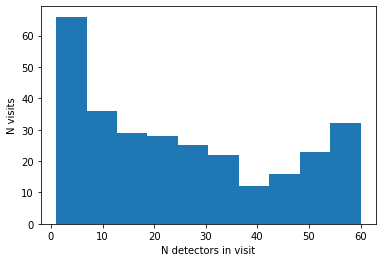

In [46]:
plt.hist(detPerVisit['n_detectors'])
plt.ylabel('N visits')
plt.xlabel('N detectors in visit')

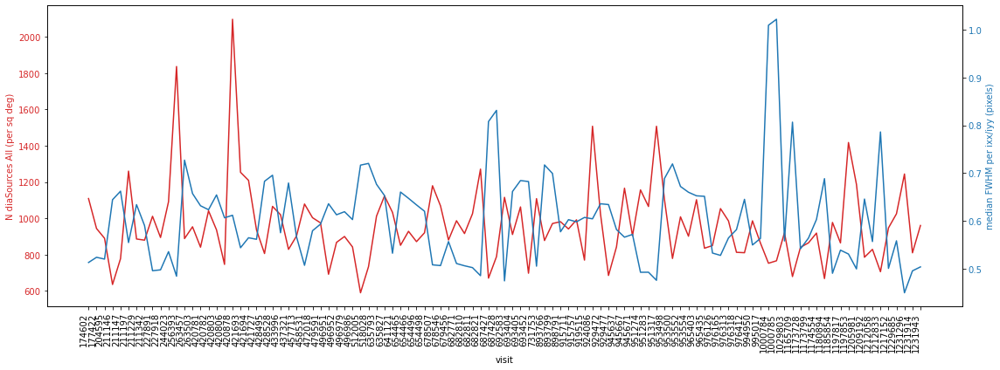

In [47]:
MIN_DETECTORS = 30
vgrp = ds[ds.n_detectors > MIN_DETECTORS].groupby('visit')
plot2axes(vgrp.visit.first().values, vgrp.detector.count().values/vgrp.n_detectors.first().values/APPROX_CCD_AREA,
          vgrp.visit.first().values, vgrp.seeing.median().values,
          'visit','N diaSources All (per sq deg)',
          'median FWHM per ixx/iyy (pixels)')

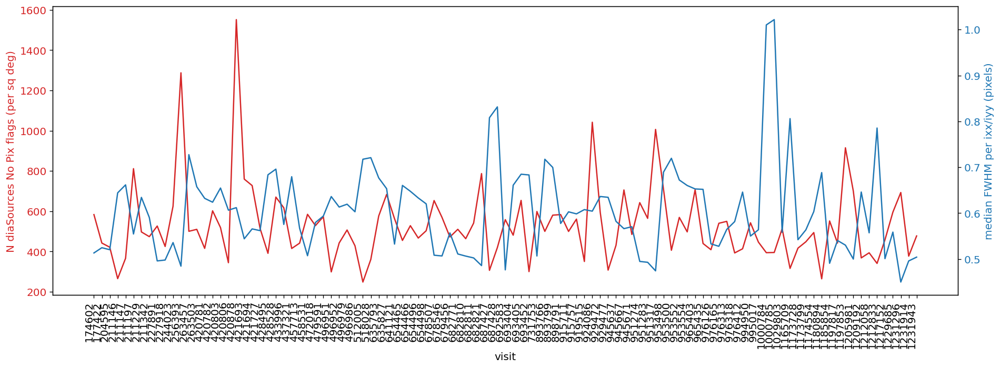

In [235]:
idx = ds[badFlagNames].sum(axis = 1) == 0 
vgrpClean = ds[(ds.n_detectors > MIN_DETECTORS)&(idx)].groupby('visit')

plot2axes(vgrpClean.visit.first().values, vgrpClean.detector.count().values/vgrpClean.n_detectors.first().values/APPROX_CCD_AREA,
          vgrpClean.visit.first().values, vgrpClean.seeing.median().values,
          'visit','N diaSources No Pix flags (per sq deg)',
          'median FWHM per ixx/iyy (pixels)')

In [50]:
def n(v):
    return v*np.exp(-0.5*v*v)/(2**(5/2) * np.pi**(3/2))

def expected(low, high, seeing=3, nCcds=1):
    """seeing must be supplied as sigma)
    """
    inBetween = n(low) - n(high)
    return inBetween * 2 * nCcds * bbox.getWidth()*bbox.getHeight() / (seeing**2)


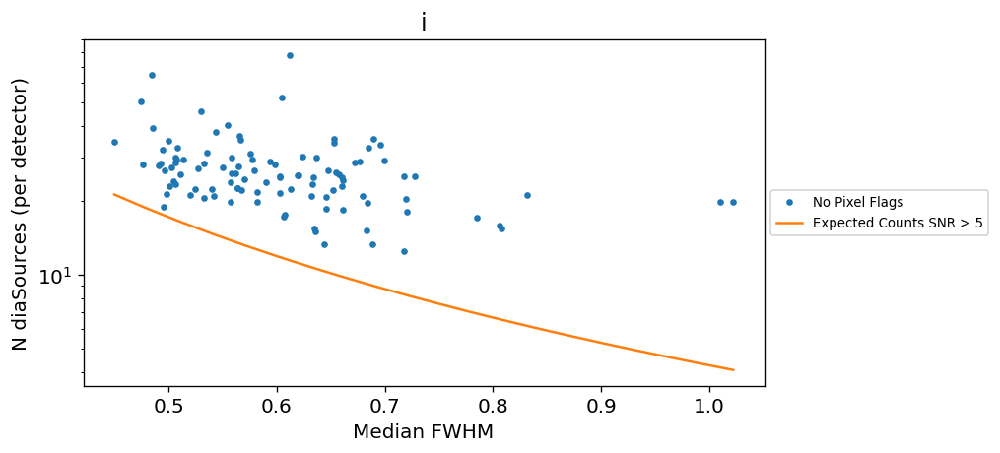

In [234]:
band='i'
idx = ds[badFlagNames].sum(axis = 1) == 0 
vgrp = ds[(ds.filterName == band) & (ds.n_detectors > MIN_DETECTORS)].groupby('visit')
vgrpClean = ds[(ds.filterName == band) & (ds.n_detectors > MIN_DETECTORS)&(idx)].groupby('visit')

seeingRange = np.linspace(np.min(vgrp.seeing.median().values/SIGMA2FWHM/PIXEL_SCALE), 
                         np.max(vgrp.seeing.median().values/SIGMA2FWHM/PIXEL_SCALE),
                         20)
expectedCounts = expected(5, 100, seeingRange, 1)
plt.figure(figsize=(8,4))
ax = plt.subplot(111)
plt.yscale('log')
plt.ylabel('N diaSources (per detector)')
plt.xlabel('Median FWHM')
plt.plot(vgrpClean.seeing.median().values, vgrpClean.detector.count().values/vgrpClean.n_detectors.first().values, '.', label="No Pixel Flags")
#plt.vlines(templateSeeingDist.mean(), 20, 1000, linestyles='dashed', label="mean template", linewidth=1)
#plt.vlines(templateSeeingDist.max(), 20, 1000, linestyles='solid', label="max template", linewidth=1)
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.9, box.height])
plt.plot(seeingRange*SIGMA2FWHM*PIXEL_SCALE, expectedCounts, label="Expected Counts SNR > 5")
plt.legend(fontsize=8, loc='center left', bbox_to_anchor=(1, 0.5))
plt.title(band)
plt.tight_layout()

# DiaSources per CCD

In [245]:
vgrp = ds.groupby('detector')
vgrpClean = ds[idx].groupby('detector')
NVisits = len(np.unique(ds['detector'].values))

In [54]:
# Get corners of the ccds. You can prob do this with camera geom too. 
cornerList = []

for det in camera:
    try:
        bbox = det.getBBox()
        ccd = det.getId()
    except:
        print(det.getId)
        continue
    cornerList.append( [int(v), ccd] + [val for pair in bbox.getCorners() for val in ccd2focalPlane(pair[0], pair[1], ccd)])


corners = pd.DataFrame(cornerList)
cornerList
corners['width'] = corners[6] - corners[8]
corners['height'] = corners[7] - corners[5]

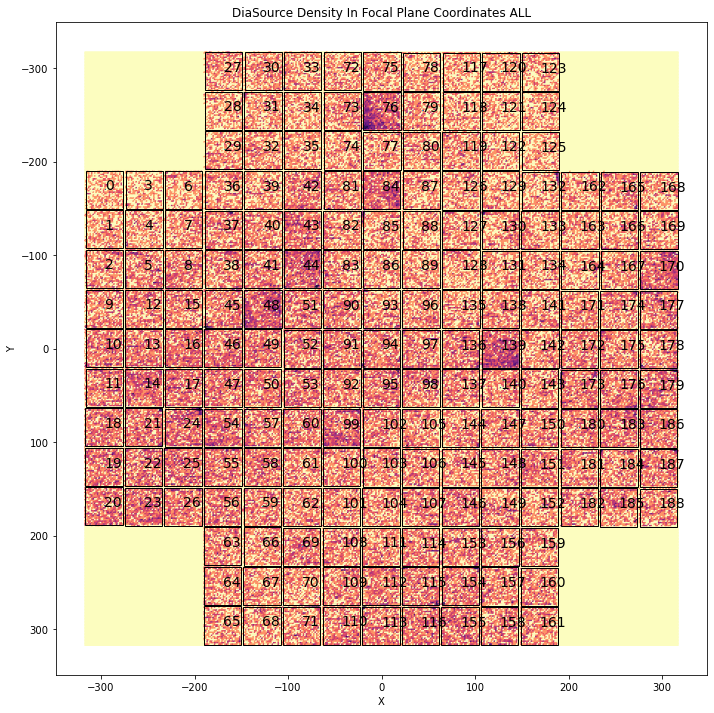

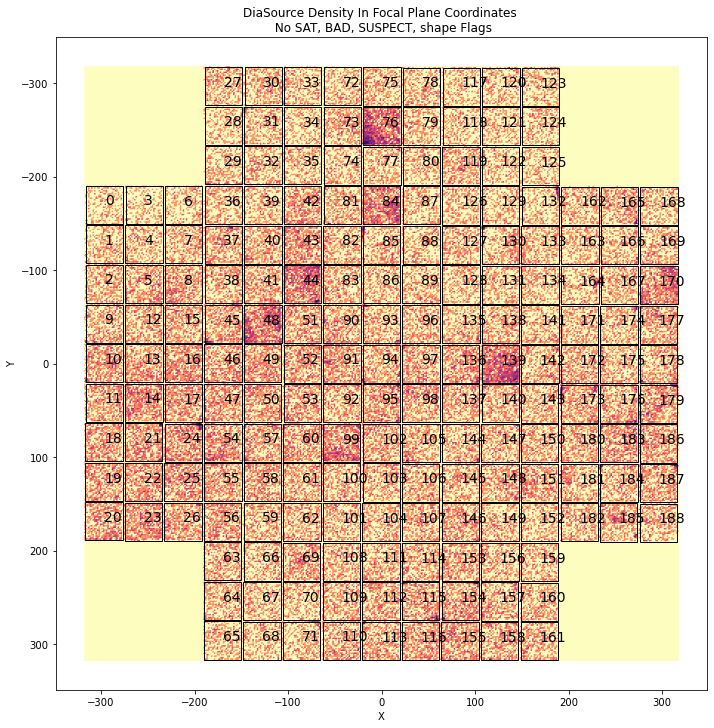

In [56]:
import matplotlib.patches as patches

fig1 = plt.figure(figsize=(12,12))
ax1 = fig1.add_subplot(111, aspect='equal')
for index, row in corners.iterrows():
    #print(row[2], row[3], -row.width, -row.height, row[2]-row.width/2, row[3]-row.height/2, '%d'%(row[1]))
    ax1.add_patch(
    patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=False))
    ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=14)
    plt.plot(row[7]-row.height/2, row[6]-row.width/2, ',')
ax1.hexbin(ds['yFP'], ds['xFP'], gridsize=(400,400), bins='log', cmap='magma_r')
ax1.set_title('DiaSource Density In Focal Plane Coordinates ALL')
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1 = plt.gca()
ax1.invert_yaxis()
plt.show()
    
for ind, title in [
                   (idx, "No Pixel Flags"),
                #   (idxHighSNR, "No SAT, BAD, SUSPECT, shape Flags and SNR > 5")
]:

    fig1 = plt.figure(figsize=(12,12))
    ax1 = fig1.add_subplot(111, aspect='equal')
    for index, row in corners.iterrows():
        #print(row[2], row[3], -row.width, -row.height, row[2]-row.width/2, row[3]-row.height/2, '%d'%(row[1]))
        ax1.add_patch(
        patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=False))
        ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=14)
        plt.plot(row[7]-row.height/2, row[6]-row.width/2, ',')
    ax1.hexbin(ds[idx]['yFP'], ds[idx]['xFP'], gridsize=(400,400), bins='log', cmap='magma_r')
    ax1.set_title('DiaSource Density In Focal Plane Coordinates \n %s' %(title))
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    ax1 = plt.gca()
    ax1.invert_yaxis()
    plt.show()

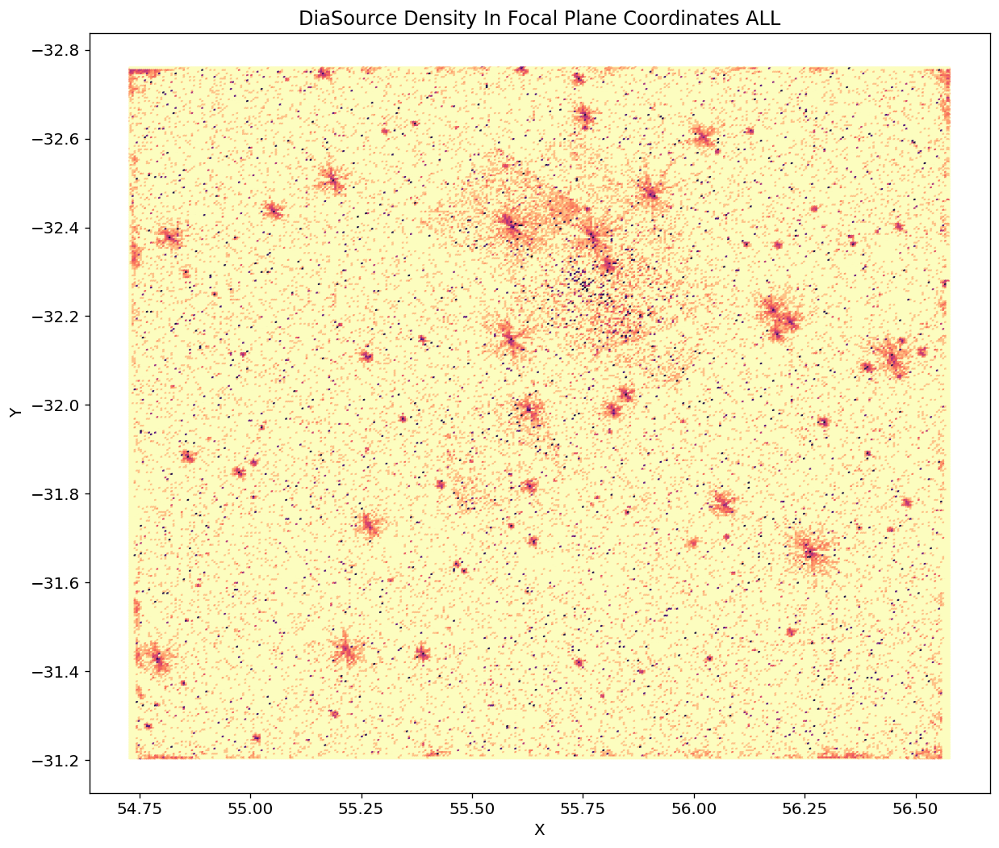

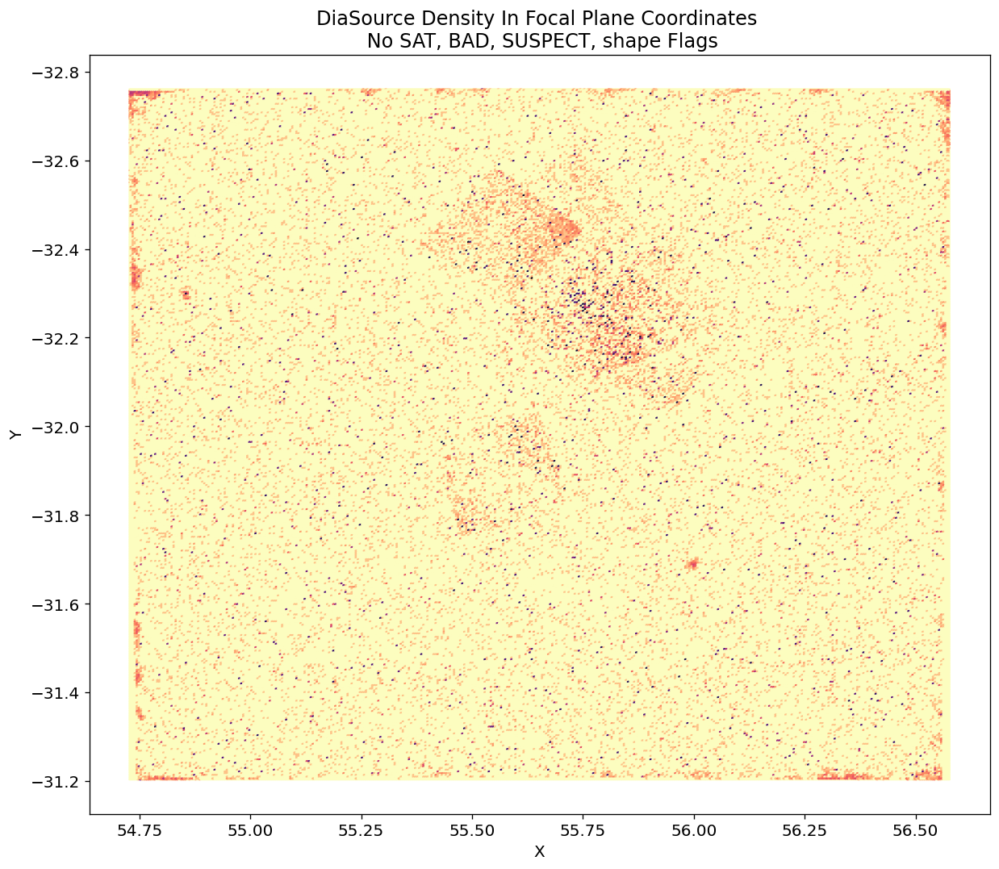

In [186]:
import matplotlib.patches as patches

fig1 = plt.figure(figsize=(12,12))
ax1 = fig1.add_subplot(111, aspect='equal')
ax1.hexbin(ds['ra'], ds['decl'], gridsize=(400,400), bins='log', cmap='magma_r')
ax1.set_title('DiaSource Density In Focal Plane Coordinates ALL')
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1 = plt.gca()
ax1.invert_yaxis()
plt.show()
    
for ind, title in [
                   (idx, "No SAT, BAD, SUSPECT, shape Flags"),
                #   (idxHighSNR, "No SAT, BAD, SUSPECT, shape Flags and SNR > 5")
]:

    fig1 = plt.figure(figsize=(12,12))
    ax1 = fig1.add_subplot(111, aspect='equal')
    ax1.hexbin(ds[idx]['ra'], ds[idx]['decl'], gridsize=(400,400), bins='log', cmap='magma_r')
    ax1.set_title('DiaSource Density In Focal Plane Coordinates \n %s' %(title))
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    ax1 = plt.gca()
    ax1.invert_yaxis()
    plt.show()

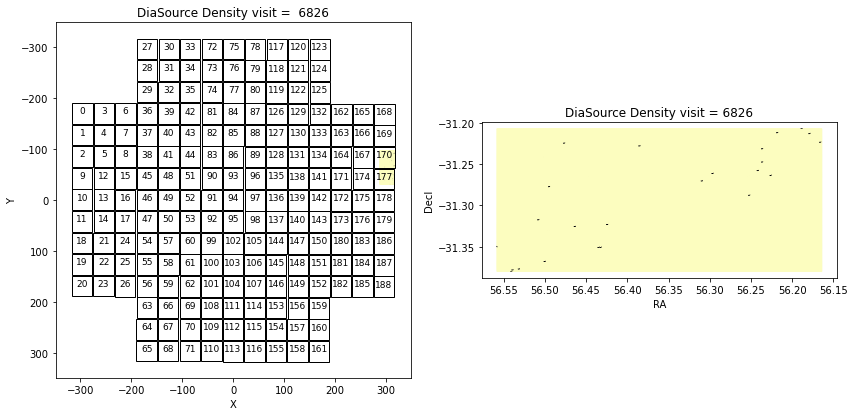

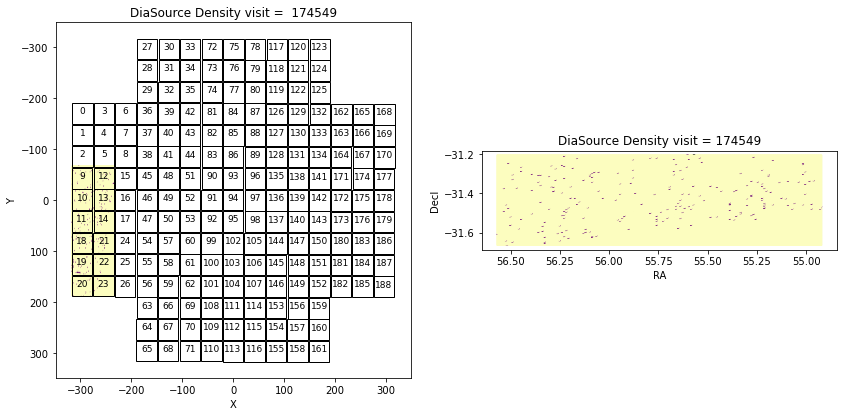

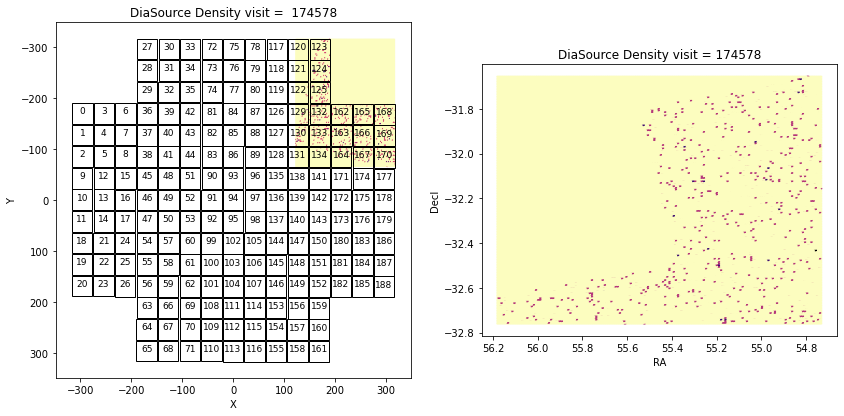

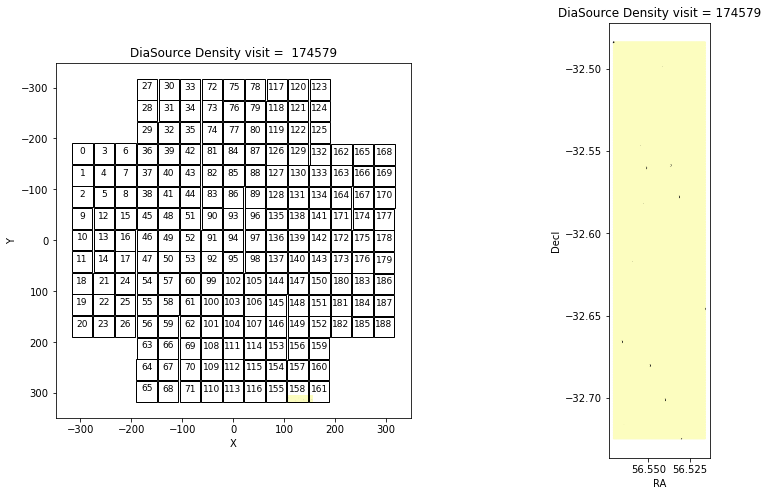

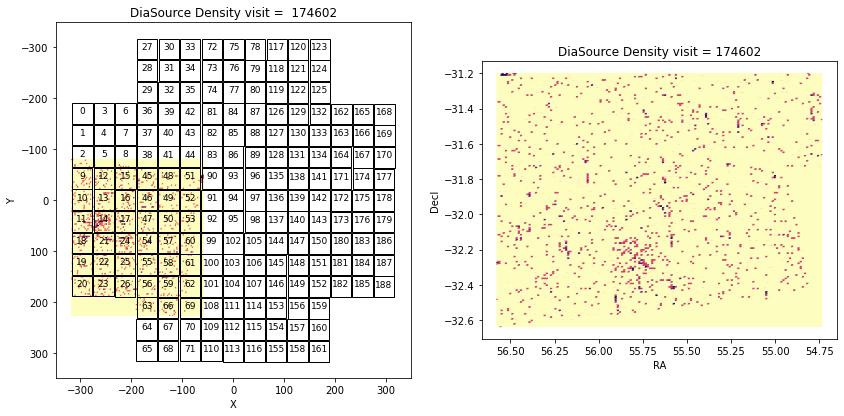

...

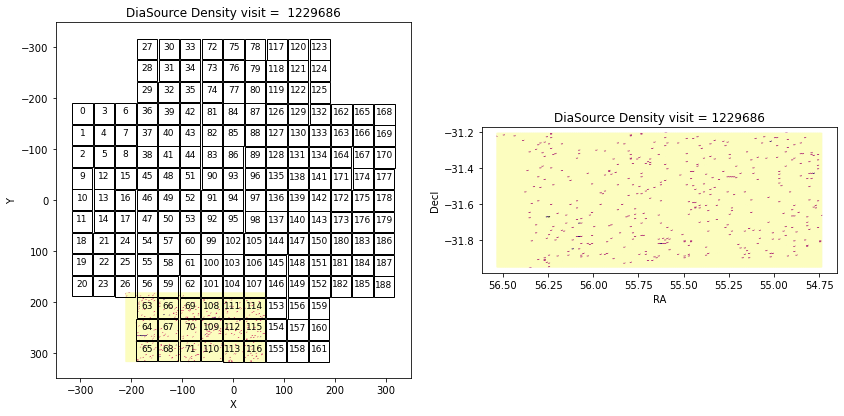

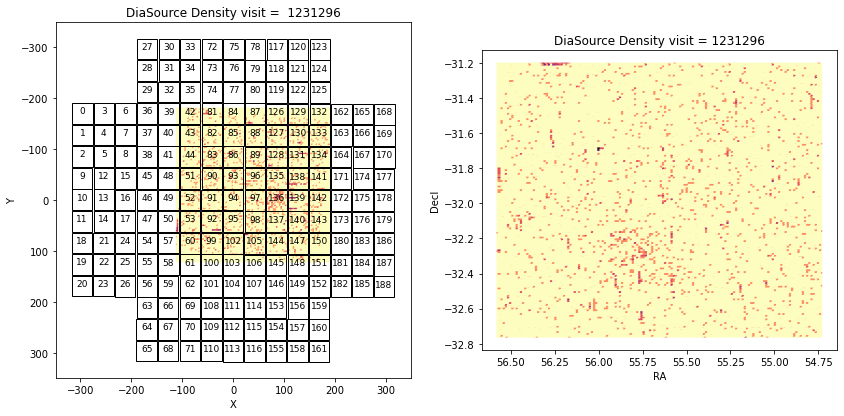

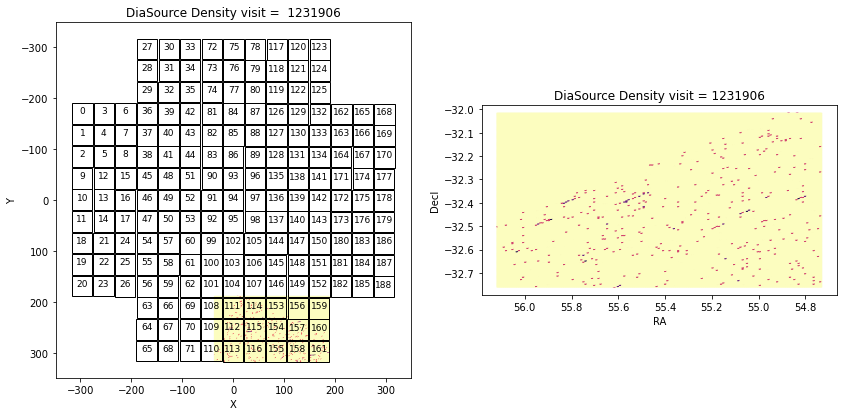

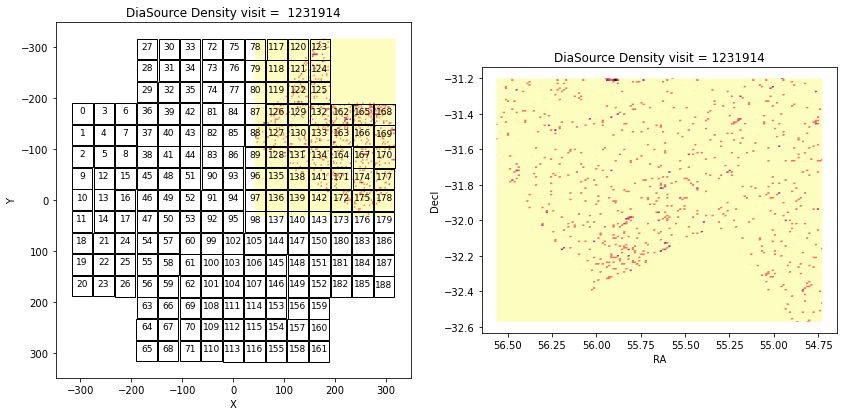

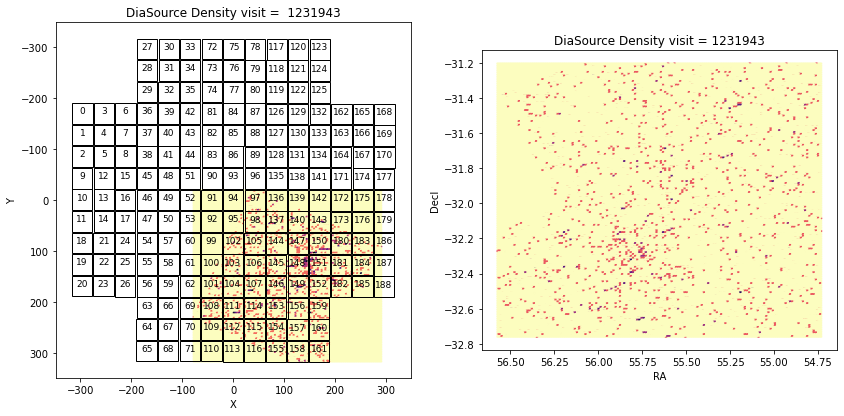

In [58]:
#PER VISIT
for v in np.unique(ds['visit'].values):
    ind = ds.visit == v
    fig1 = plt.figure(figsize=(14, 8))
    ax1 = fig1.add_subplot(121, aspect='equal')
    ax1.hexbin(ds.yFP[ind], ds.xFP[ind], gridsize=(100,100), bins='log', cmap='magma_r')
    for index, row in corners.iterrows():
        ax1.add_patch( patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=False))
        ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=9, ha='center')
    ax1.set_title('DiaSource Density visit =  %s' % v)
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    ax1 = plt.gca()
    ax1.invert_yaxis()
    
    ax1 = fig1.add_subplot(122, aspect='equal')
    #for index, row in corners.iterrows():
    #    ax1.add_patch( patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=False))
    #    ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=14)
    ax1.hexbin(ds.ra[ind], ds.decl[ind], gridsize=(150,150), bins='log', cmap='magma_r')
    ax1.set_title('DiaSource Density visit = %s' % v)
    ax1.set_xlabel('RA')
    ax1.set_ylabel('Decl')
    ax1 = plt.gca()
    ax1.invert_xaxis()
    plt.show()

    

(-204.80000450560004, 4300.800004505601, -204.8, 4300.8)

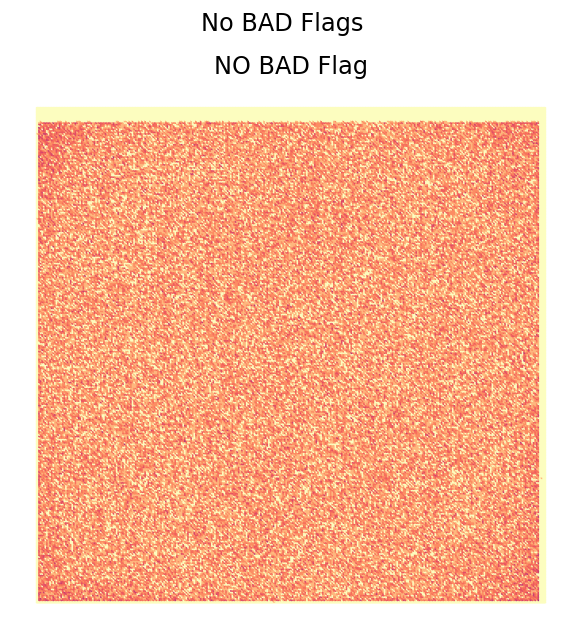

In [238]:
fig = plt.figure(figsize=(6, 6))
fig.suptitle('No BAD Flags')
ax = fig.add_subplot(1,1,1)
ax.hexbin(ds.x[~ds['base_PixelFlags_flag_bad']],
          ds.y[~ds['base_PixelFlags_flag_bad']], gridsize=(320,320), bins='log',
          extent= [0,4096,0,4096], cmap='magma_r',  vmin=1, vmax=100)
plt.axis('off')

(-204.80000450560004, 4300.800004505601, -204.8, 4300.8)

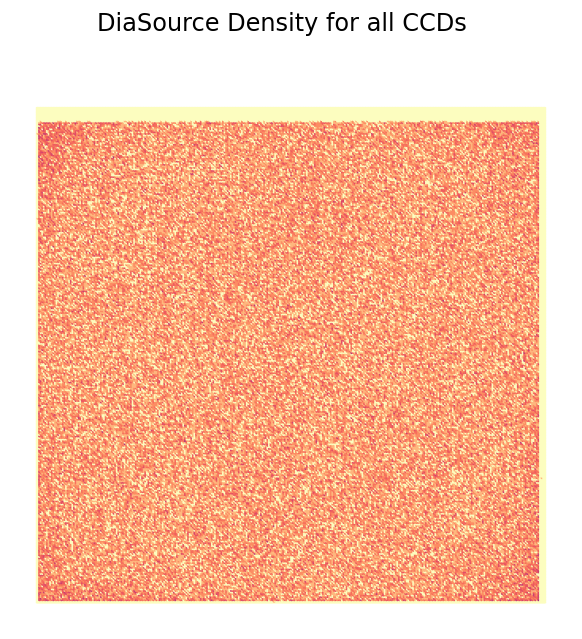

In [239]:
fig = plt.figure(figsize=(6, 6))
fig.suptitle('DiaSource Density for all CCDs')
ax = fig.add_subplot(1,1,1)
ax.hexbin(ds.x,
          ds.y, gridsize=(320,320), bins='log',
          extent= [0,4096,0,4096], cmap='magma_r',  vmin=1, vmax=100)
plt.axis('off')

In [61]:
ds['date_time'] = pd.to_datetime(ds.midPointTai, unit='D', origin=pd.Timestamp('1858-11-17'))
ds['date'] = ds['date_time'].dt.date

In [62]:
night_count = ds.groupby(['visit','date']).count()

# DiaSources per night


In [63]:
visits_per_night = night_count.groupby('date').count()
dia_per_night = night_count.groupby('date').sum()
pervisit_per_night = night_count.groupby('date').mean()
pervisit_per_night_std = night_count.groupby('date').std()

In [64]:
per_night = pd.merge(visits_per_night['x'], dia_per_night['x'], right_index=True, left_index=True)

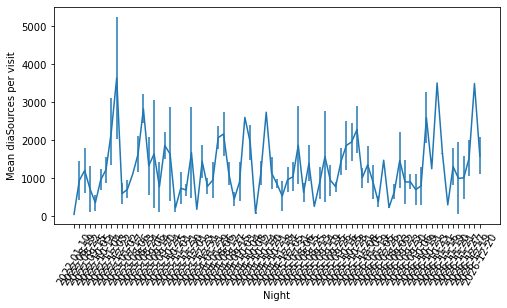

(0.0, 18.0)

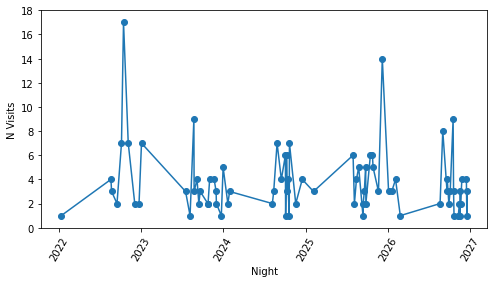

In [65]:
plt.figure(figsize=(8,4))
plt.errorbar(pervisit_per_night.index.values.astype('str'), pervisit_per_night['x'],
             yerr=pervisit_per_night_std['x']/np.sqrt(visits_per_night['x']))
#plt.xticks(pervisit_per_night.index.values.astype('str'))
_ = plt.xticks(rotation=60)
plt.xlabel('Night')
plt.ylabel('Mean diaSources per visit')
plt.show()
plt.figure(figsize=(8,4))
plt.plot(visits_per_night.index, visits_per_night['x'], 'o-')
_ = plt.xticks(rotation=60)
plt.xlabel('Night')
plt.ylabel('N Visits')
plt.ylim(0, np.max(visits_per_night['x'].values + 1))


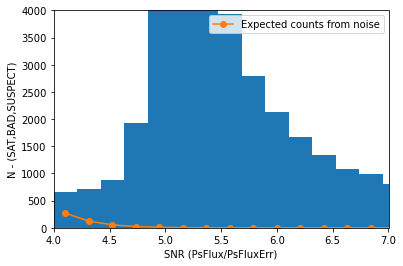

In [67]:
"""
pixelFlags = ['base_PixelFlags_flag_saturated', 
                'base_PixelFlags_flag_suspect',
                'base_PixelFlags_flag_bad',]
idxPixel = ds[pixelFlags].sum(axis = 1) == 0 

bins = np.linspace(4,8,20)
plt.xlim(4,7)
plt.ylim(0, 4000)
flux = "psFlux"
arr = ds[flux]/ds[flux + "Err"]
plt.hist(arr[idxPixel], bins=bins)
plt.plot(0.5*(bins[:-1] + bins[1:]), expected(bins[:-1], bins[1:], 
                                              seeing=4/SIGMA2FWHM), 
         'o-', label="Expected counts from noise")
plt.ylabel("N - (SAT,BAD,SUSPECT)")
plt.xlabel("SNR (PsFlux/PsFluxErr)")
plt.legend()
plt.show()
"""


# Variance Plane as compared to the empirical variance:

1) Scrape the scale factor from the logs

2) Open up all the difference exps and grab the fraction of the image that is NaN (because of no template). This was run in a script  `/project/yusra/dc2_w_2021_20/writeNoData.py` because it takes few hours to read ~7k difference images. 
```    
exp = butler.get('goodSeeingDiff_differenceExp', dataId=dataId)
fraction = np.sum(np.isnan(exp.image.array))/exp.getBBox().getArea()
    ```

Scale Factor is the number that the variance plane is multiplies by before detection to make it match the empirical variance. If it is > 1, that means that the variance plane underestimated the empirical image variance. If it is < 1, that means that the variance plane overestimated the empirical image variance

In [207]:
filename = '/project/yusra/dc2_w_2021_20/submit/u/yusra/w_2021_21_diffim/20210523T185516Z/jobs/imageDifferenceScaleVariance.log'
with open(filename) as f:
    f = f.readlines()

var = []
for line in f:
    try:
        split1 = line.split('detector:')[1].split(', visit:')
        detector = split1[0]
        visit = split1[1].split(',')[0]
        scaleFactor = split1[1].split('by')[1]
        var.append((int(visit), int(detector), float(scaleFactor)))
    except:
        print(line)

./5965_imageDifference_693451_131.341488.err:WARN  2021-05-23T14:37:14.874-0500 imageDifference.scaleVariance (imageDifference:{instrument: 'LSSTCam-imSim', skymap: 'DC2', detector: 131, visit: 693451, ...})(scaleVariance.py:125)- Pixel-based variance rescaling factor (65.352730) exceeds configured limit (10.000000); trying image-based method

./5965_imageDifference_693451_131.341488.err:    diffimVarFactor = self.scaleVariance.run(subtractedExposure.getMaskedImage())

./5965_imageDifference_693451_131.341488.err:  File "/software/lsstsw/stack_20210520/stack/miniconda3-py38_4.9.2-0.6.0/Linux64/pipe_tasks/21.0.0-85-g296c1d01+b03e50f043/python/lsst/pipe/tasks/scaleVariance.py", line 129, in run



Text(0.5, 0, 'Scale Factor')

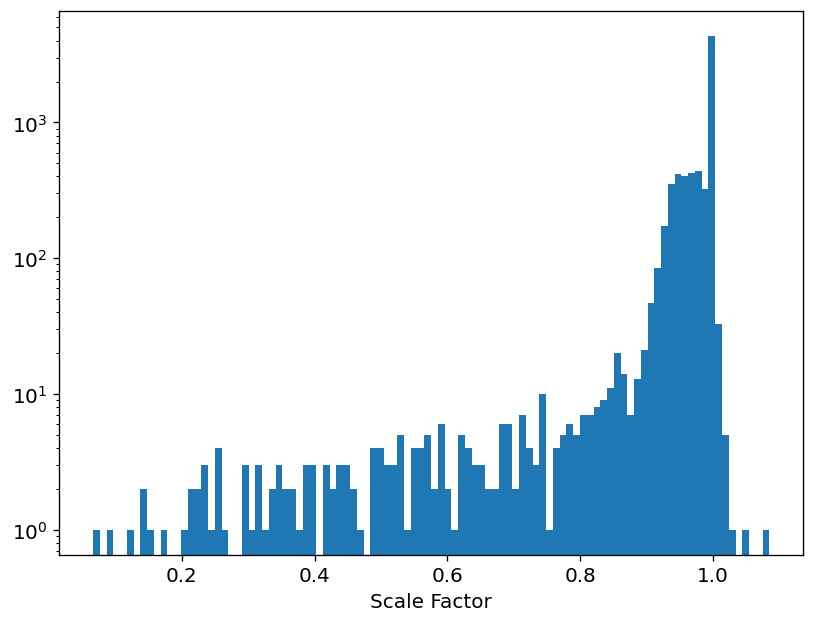

In [208]:
varianceDF = pd.DataFrame(var)
varianceDF.columns = ['visit', 'detector', 'scaleFactor']
_ = plt.hist(varianceDF.scaleFactor, bins=100, log=True)
plt.xlabel("Scale Factor")

There are actually 3 populations here:
* The long tail for images with < 5% data
* Better seeing population centered at 0.9
* Worse seeing population centered at 1. 

In [121]:
dsWVar = pd.merge(ds.groupby(['ccdVisitId', 'visit', 'detector']).first().reset_index(), 
                  varianceDF, right_on= ('visit', 'detector'), left_on= ('visit', 'detector'))
nodata = pd.read_csv('/project/yusra/dc2_w_2021_20/tract4431-i.csv', header=None)
nodata.columns = ['visit', 'detector', 'no_data']
dsWVar = pd.merge(nodata, dsWVar, right_on= ('visit', 'detector'), left_on= ('visit', 'detector'))

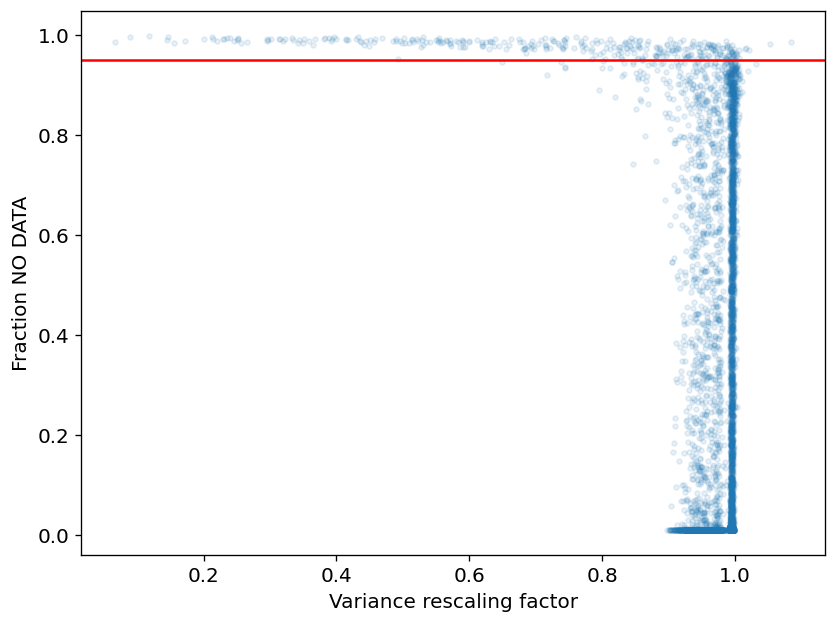

In [209]:
plt.plot(dsWVar.scaleFactor, dsWVar.no_data,'.', alpha=0.1)
plt.ylabel('Fraction NO DATA')
plt.xlabel('Variance rescaling factor')
plt.axhline(0.95, color='r')

Text(0.5, 0, 'Variance rescaling factor')

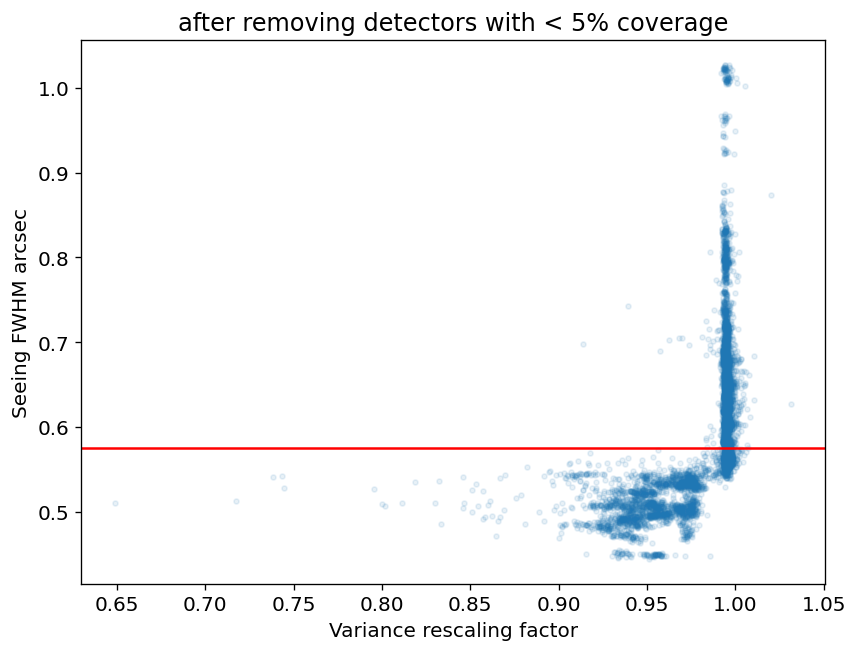

In [227]:
plt.title('after removing detectors with < 5% coverage')
plt.plot(dsWVar[dsWVar.no_data < 0.95].scaleFactor, dsWVar[dsWVar.no_data < 0.95].seeing, '.', alpha=0.1)
plt.axhline(0.575, color='r')
plt.ylabel('Seeing FWHM arcsec')
plt.xlabel('Variance rescaling factor')

Text(0.5, 0, 'Variance rescaling factor')

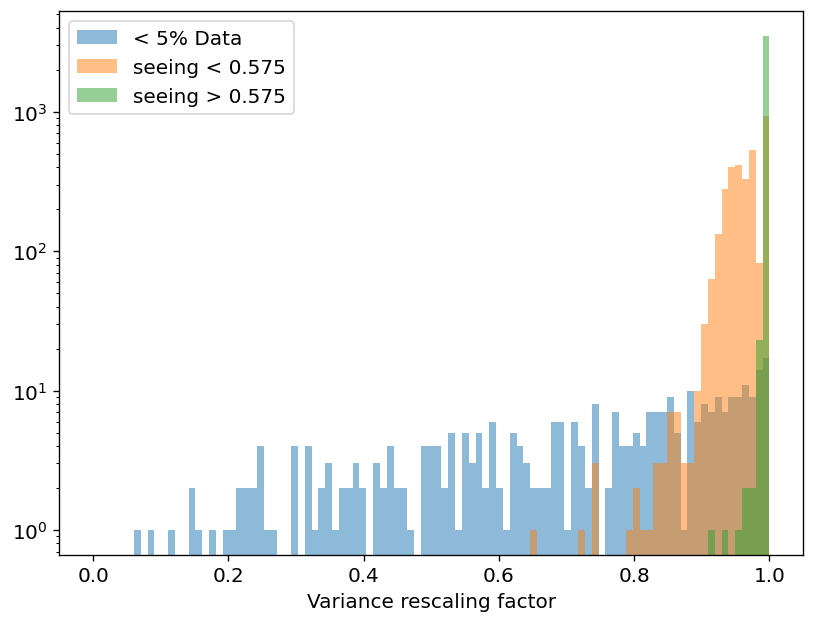

In [225]:
_ = plt.hist(dsWVar.scaleFactor[(dsWVar.no_data > 0.95)],
             alpha=0.5, bins=np.linspace(0, 1, 100), log=True, label='< 5% Data')
_ = plt.hist(dsWVar.scaleFactor[(dsWVar.seeing < 0.575) & (dsWVar.no_data < 0.95)],
             alpha=0.5, bins=np.linspace(0, 1, 100), log=True, label='seeing < 0.575')
_ = plt.hist(dsWVar.scaleFactor[(dsWVar.seeing > 0.575) & (dsWVar.no_data < 0.95)],  
             alpha=0.5, bins=np.linspace(0, 1, 100), log=True, label='seeing > 0.575')
plt.legend()
plt.xlabel('Variance rescaling factor')

## Conclusions
1) More evidence that we shouldn't bother with detectors with < 5% template coverage.

In [385]:
visit=433992; detector=122
visit=2336; detector=47
dataId = dict(visit=visit, detector=detector)
exp = butler.get('goodSeeingDiff_differenceExp', dataId=dataId)
cat = butler.get('goodSeeingDiff_diaSrc', dataId=dataId)
display.mtv(exp)


In [243]:
countsDF = ds.groupby(['ccdVisitId', 'visit', 'detector']).count().reset_index()
print(countsDF.sort_values('x')[['visit', 'detector', 'x']].head())
print(countsDF.sort_values('x')[['visit', 'detector', 'x']].tail())

        visit  detector  x
5290   965435        88  1
5339   976126       104  1
5343   976126       114  1
655    211529       170  1
6762  1212058       105  1
        visit  detector     x
977    256393        48  1280
973    256393        44  1458
4886   951317        84  1580
6529  1197853       139  1721
6386  1196406        76  2734


In [130]:
masks = {'BAD': 'red',
         'CR': 'magenta',
         'EDGE': 'yellow',
         'SAT': 'green',
         'DETECTED': 'blue',
         'DETECTED_NEGATIVE': 'cyan',
         'NO_DATA': 'orange',
         'INTERPOLATED': 'magenta'
        }

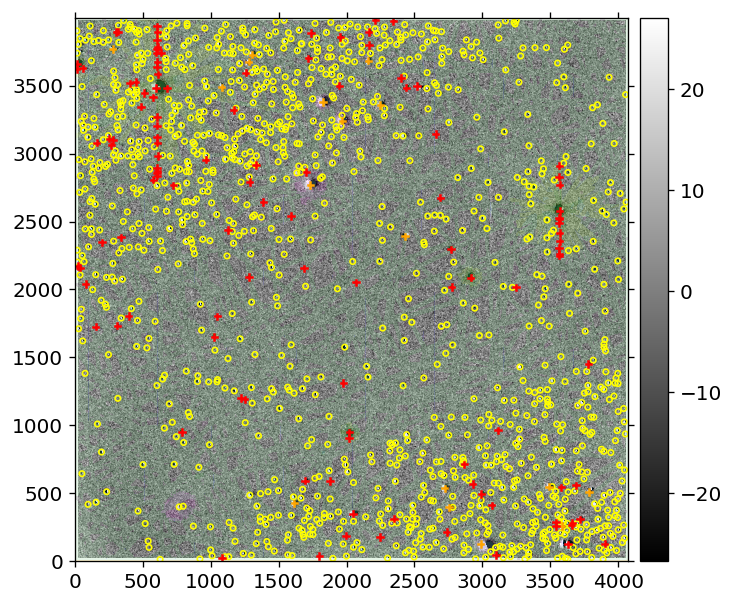

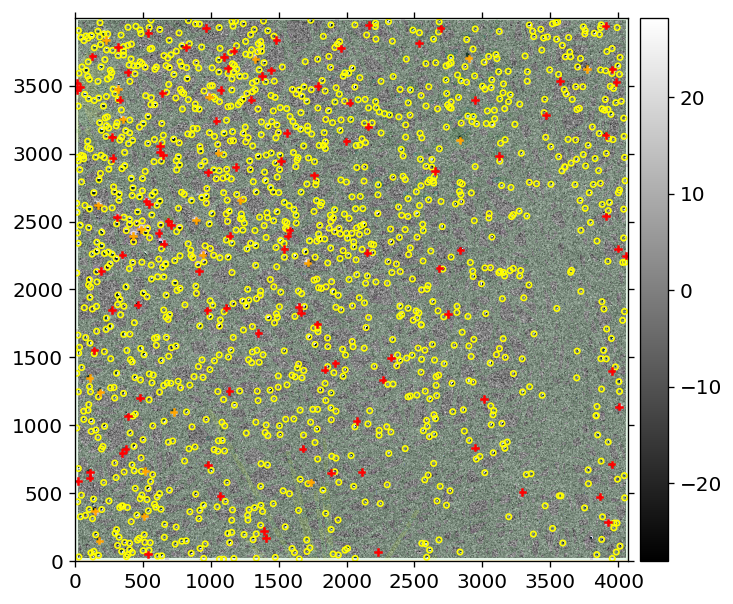

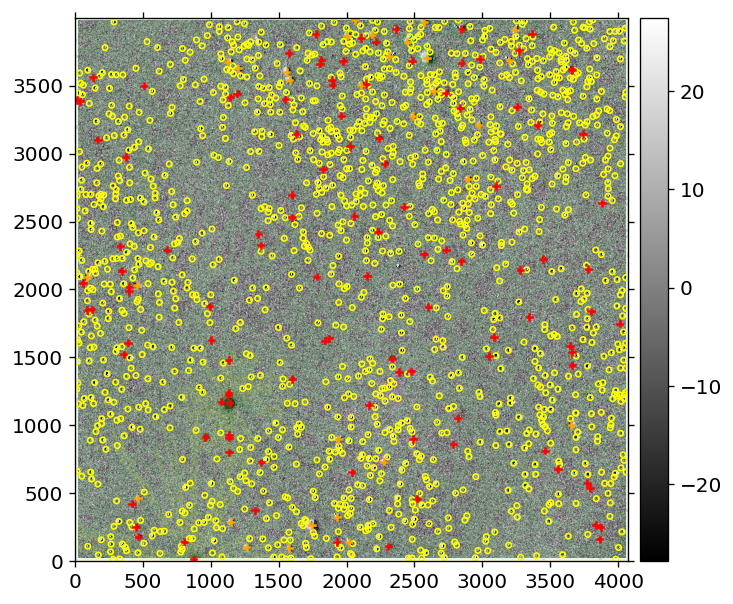

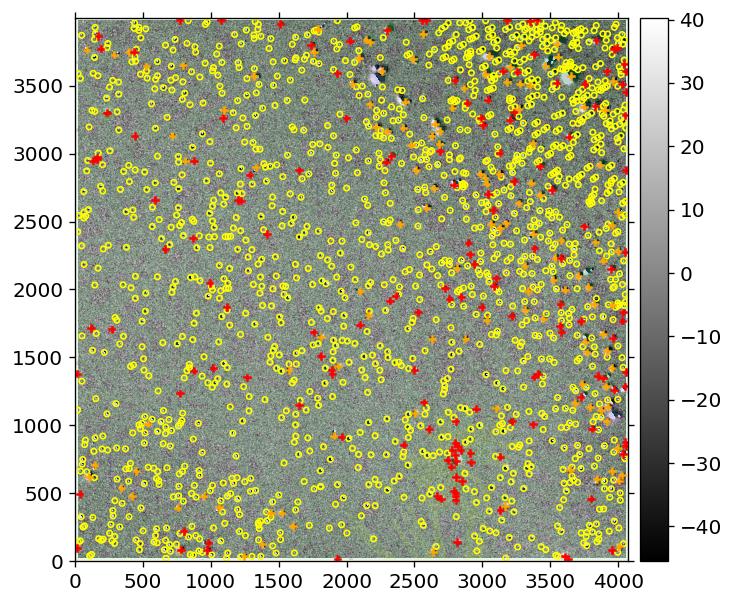

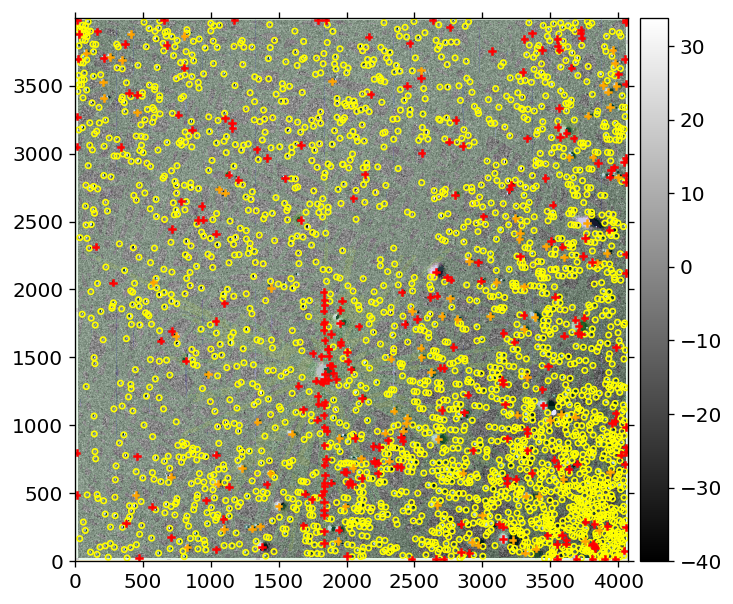

In [137]:
matplotlib.rcParams["figure.figsize"] = (8, 6)
matplotlib.rcParams["font.size"] = 12
matplotlib.rcParams["figure.dpi"] = 120


for i, row in enumerate(countsDF.sort_values('x')[['visit', 'detector', 'x']].tail().iterrows()):
    visit=row[1].visit
    detector=row[1].detector
    display1 = afw_display.Display(frame=i+1, backend='matplotlib')
    display1.scale("linear", "zscale")
    display1.setDefaultMaskTransparency(90)
    display1.setMaskPlaneColor(masks)
    dataId = dict(visit=visit, detector=detector)
    exp = butler.get('goodSeeingDiff_differenceExp', dataId=dataId)
    exp.image.array[:] = gaussian(exp.image.array, sigma=3)
    cat = butler.get('goodSeeingDiff_diaSrc', dataId=dataId)
    display1.mtv(exp)
    with display1.Buffering():
        for record in cat:
            if (record['base_PixelFlags_flag'] | 
                record['base_PixelFlags_flag_offimage'] |
                record['base_PixelFlags_flag_edge'] |
                record['base_PixelFlags_flag_interpolated'] | 
                record['base_PixelFlags_flag_saturated'] | 
                record['base_PixelFlags_flag_cr'] | 
                record['base_PixelFlags_flag_bad'] | 
                record['base_PixelFlags_flag_suspect'] | 
                record['base_PixelFlags_flag_interpolatedCenter'] | 
                record['base_PixelFlags_flag_saturatedCenter'] | 
                record['base_PixelFlags_flag_crCenter'] | 
                record['base_PixelFlags_flag_suspectCenter'] 
                 ):
                display1.dot('+', record.getX(), record.getY(), size=20, ctype='red')
            elif record.getFootprint().getArea() > 1000:
                display1.dot('+', record.getX(), record.getY(), size=20, ctype='orange')
            else:
                display1.dot('o', record.getX(), record.getY(), size=20, ctype='yellow')
    display1.show()

In [250]:
countsDF.sort_values('x')[['visit', 'detector', 'x']].iloc[3000]

visit       953554
detector       105
x               38
Name: 5125, dtype: int64

# Interactive display

In [ ]:
afwDisplay.setDefaultBackend('firefly')
display = afwDisplay.Display(backend='firefly', url='http://lsst-demo.ncsa.illinois.edu/firefly')
display.getClient().get_firefly_url()
display.setMaskTransparency(50)
display.scale("linear", "zscale")

In [ ]:
visit=433992; detector=122
visit=2336; detector=47
dataId = dict(tract=3828, band='z', patch=9)
exp = butler.get('goodSeeingCoadd_nImage', dataId=dataId)
#cat = butler.get('goodSeeingDiff_diaSrc', dataId=dataId)
display.mtv(exp)

In [386]:
with display.Buffering():
    for record in cat:
        if (record['base_PixelFlags_flag_interpolated']):
            display.dot('o', record.getX(), record.getY(), size=20, ctype='magenta')
        if ( record['base_PixelFlags_flag_cr'] 
            #record['base_PixelFlags_flag_interpolatedCenter'] | 
            #record['base_PixelFlags_flag_saturatedCenter'] | 
           # record['base_PixelFlags_flag_crCenter'] | 
            #record['base_PixelFlags_flag_suspectCenter']
           ):
            display.dot('x', record.getX(), record.getY(), size=20, ctype='magenta')
        if (record['base_PixelFlags_flag_saturated']  
            #record['base_PixelFlags_flag_interpolatedCenter'] | 
            #record['base_PixelFlags_flag_saturatedCenter'] | 
           # record['base_PixelFlags_flag_crCenter'] | 
            #record['base_PixelFlags_flag_suspectCenter']
           ):
            display.dot('*', record.getX(), record.getY(), size=20, ctype='orange')
        if(
            record['base_PixelFlags_flag_offimage'] |
            record['base_PixelFlags_flag_edge'] |
            record['base_PixelFlags_flag_bad'] | 
            record['base_PixelFlags_flag_suspect']
            ):
            display.dot('*', record.getX(), record.getY(), size=20, ctype='red')
        if record.getFootprint().getArea() > 1000:
            display.dot('+', record.getX(), record.getY(), size=20, ctype='orange')
        #else:
         #   display.dot('o', record.getX(), record.getY(), size=20, ctype='yellow')

In [240]:
## Moved to script

#import lsst.daf.butler as dafButler
#PARENT_REPO = " 2.2i/defaults"
#butler = dafButler.Butler('/repo/dc2', collections='u/yusra/w_2021_21_diffim')
#visits =  butler.registry.queryDataIds(["visit", "detector"], datasets="goodSeeingDiff_differenceExp",
#                                       collections='u/yusra/w_2021_21_diffim',
#                                       where="instrument='LSSTCam-imSim' AND tract=4431")
#tuples = set([(dataId['visit'], dataId['detector']) for dataId in visits])
#with open('tract4431-i.csv', 'w') as f:
#    for visit, detector in tuples:
#        dataId = dict(visit=visit, detector=detector)
#        exp = butler.get('goodSeeingDiff_differenceExp', dataId=dataId)
#        fraction = np.sum(np.isnan(exp.image.array))/exp.getBBox().getArea()
#        f.write('%s, %s, %s\n'%(visit, detector, fraction))
#        f.flush()

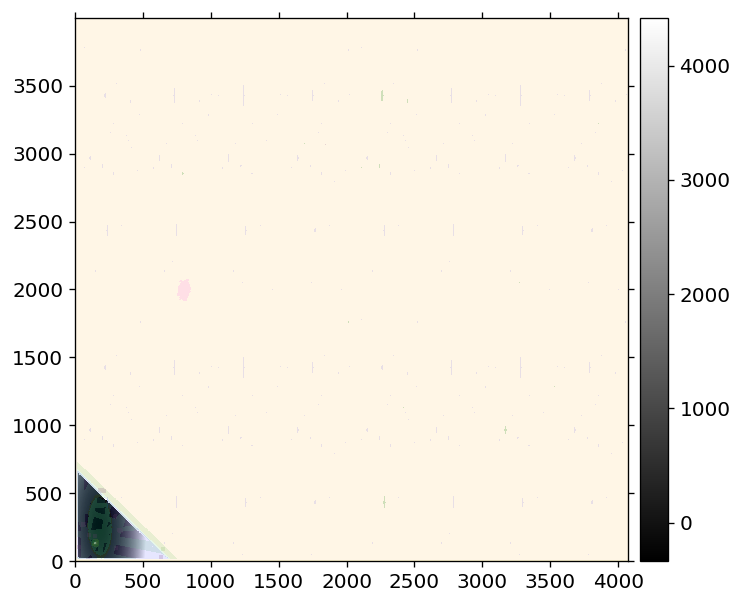

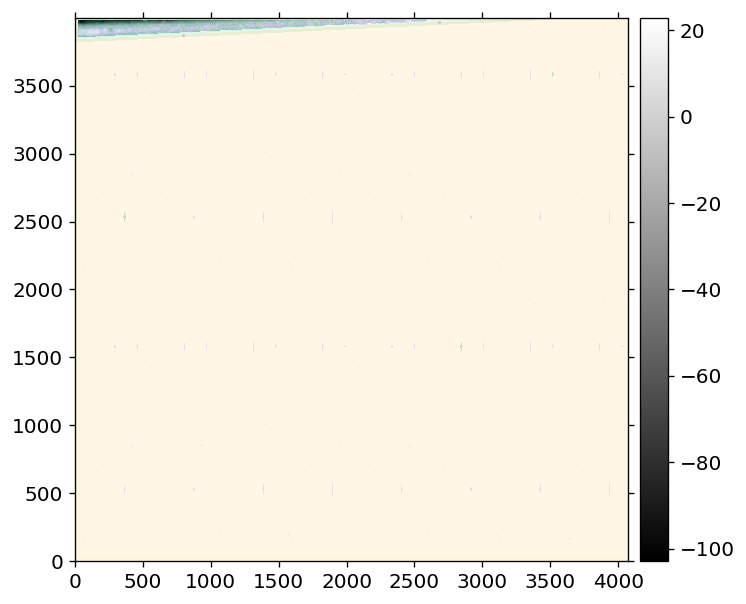

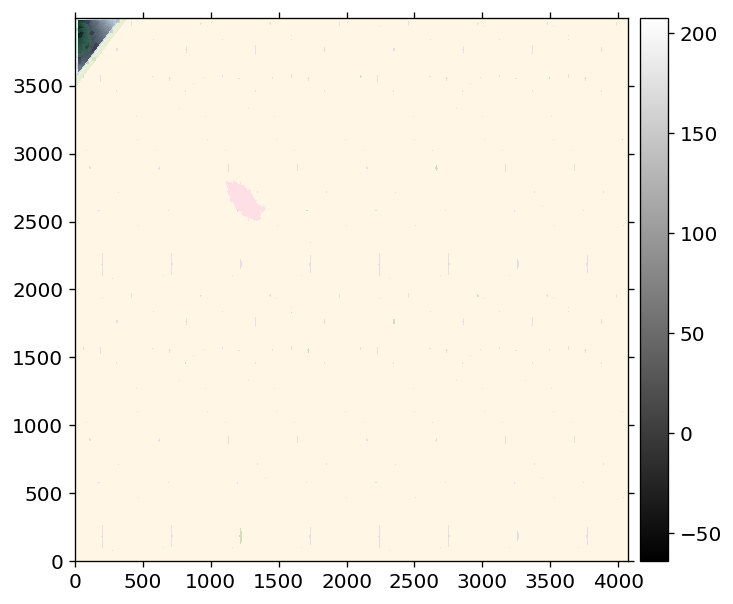

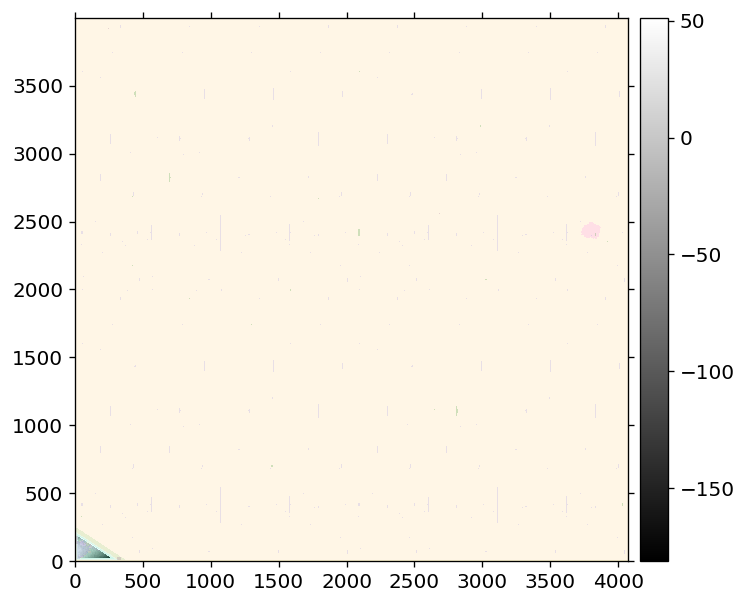

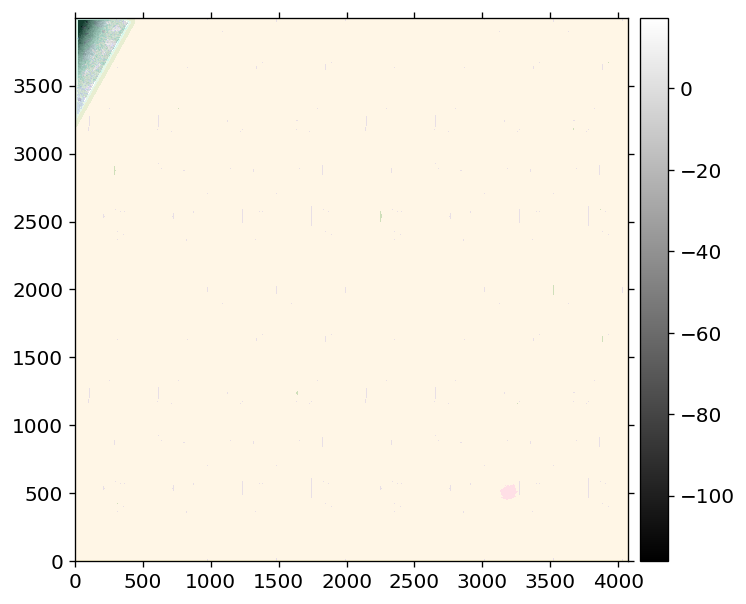

In [139]:
import lsst.afw.display as afw_display
import matplotlib
%matplotlib inline
matplotlib.rcParams["figure.figsize"] = (8, 6)
matplotlib.rcParams["font.size"] = 12
matplotlib.rcParams["figure.dpi"] = 120


for i, row in enumerate(dsWVar.sort_values('scaleFactor')[['visit', 'detector', 'seeing', 'scaleFactor']].head().iterrows()):
    visit=int(row[1].visit)
    detector=int(row[1].detector)
    display1 = afw_display.Display(frame=i+1, backend='matplotlib')
    display1.scale("linear", "zscale")
    display1.setDefaultMaskTransparency(90)
    display1.setMaskPlaneColor(masks)
    display1.mtv(exp)
    dataId = dict(visit=visit, detector=detector)
    exp = butler.get('goodSeeingDiff_differenceExp', dataId=dataId)
    exp.image.array[:] = gaussian(exp.image.array, sigma=3)
    display1.show()



# Appendix
## Flux Distributions

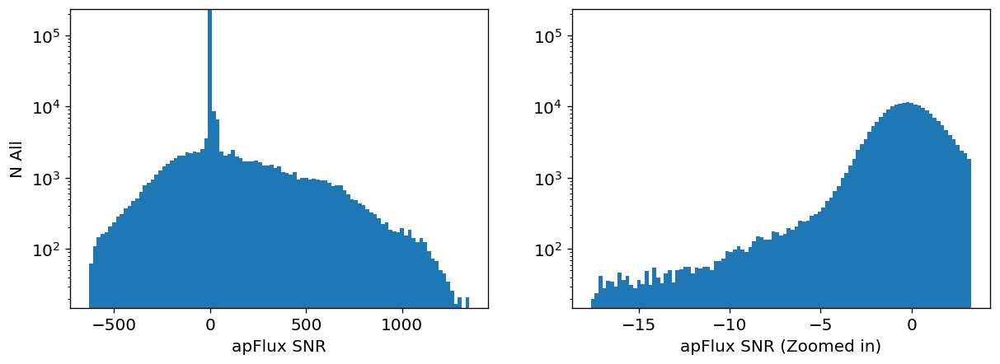

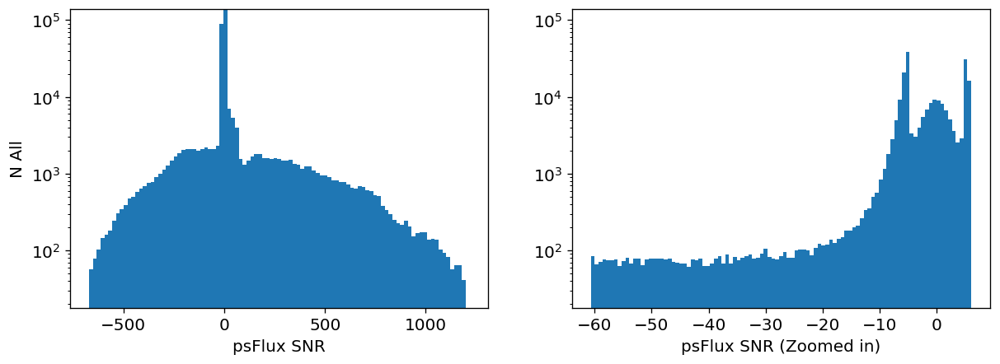

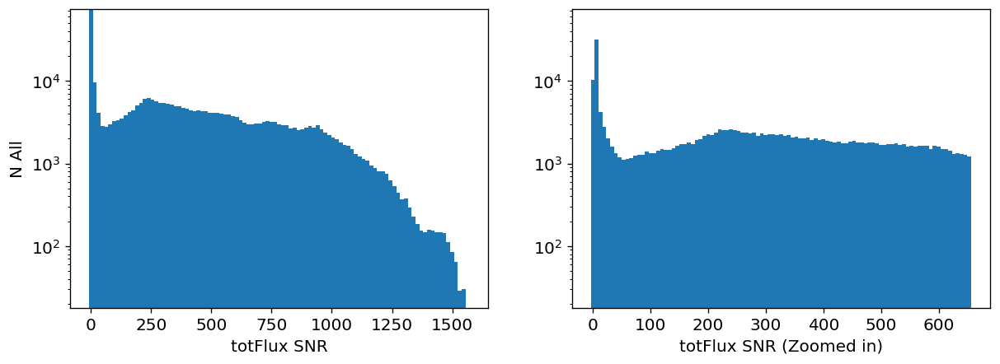

In [252]:
bins = np.linspace(-1000, 1000, 100)

fluxType = ["apFlux", "psFlux",
            "totFlux"]

for flux in fluxType:
    plt.figure(figsize = (12,4))
    arr = ds[flux]/ds[flux + "Err"]
    plt.subplot(121)

    low, high = np.percentile(arr[np.isfinite(arr)], (0.1, 99.9))
    y, x, patches = plt.hist(arr, bins=np.linspace(low, high, 100), log=True)
    plt.xlabel(flux + " SNR")
    plt.ylabel("N All")
    plt.ylim(np.min(y)+1, np.max(y)+10)
    plt.subplot(122)
    low, high = np.percentile(arr[np.isfinite(arr)], (10, 75))

    _ = plt.hist(arr, bins=np.linspace(low, high, 100), log=True)
    plt.xlabel(flux + " SNR (Zoomed in)")
    plt.ylim(np.min(y) +1 , np.max(y)+10)

    plt.show()